In [1]:
import os
import leafmap
from samgeo import SamGeo, show_image, overlay_images, SamGeo2
from pyproj import Transformer
from samgeo.text_sam import LangSAM


In [2]:
# Define the bounding box in EPSG:3857 (Web Mercator)
bbox_3857 = [-13610577.729, 4560823.588, -13609041.520, 4561655.600]

# Transform bbox to EPSG:4326 (latitude/longitude)
transformer = Transformer.from_crs("EPSG:3857", "EPSG:4326", always_xy=True)
min_lon, min_lat = transformer.transform(bbox_3857[0], bbox_3857[1])
max_lon, max_lat = transformer.transform(bbox_3857[2], bbox_3857[3])
bbox_4326 = [min_lon, min_lat, max_lon, max_lat]

print("Transformed bbox (EPSG:4326):", bbox_4326)

# Initialize the map centered around the transformed bounding box
m = leafmap.Map(center=[(min_lat + max_lat) / 2, (min_lon + max_lon) / 2], zoom=17, height="800px")
m.add_basemap("SATELLITE")



Transformed bbox (EPSG:4326): [-122.26589999657467, 37.868199999716396, -122.25209999633164, 37.874099996996726]


In [3]:
# Use your custom image
image = "ScanAI/SamGeo/Rensvik.tif"
print("File exists:", os.path.exists(image))
print("Absolute path:", os.path.abspath(image))

# Add your raster image to the map
m.add_raster(image, layer_name="Rensvik Image")
m


File exists: True
Absolute path: /home/siverteh/ScanAI/SamGeo/Rensvik.tif


Map(center=[63.0966015, 7.8194035], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title'…

In [4]:
# Initialize SAM model
sam_kwargs = {
    "points_per_side": 32,
    "points_per_batch": 8,
    "pred_iou_thresh": 0.86,
    "stability_score_thresh": 0.92,
    "crop_n_layers": 1,
    "crop_n_points_downscale_factor": 2,
    "min_mask_region_area": 100,
}
sam = SamGeo(
    model_type="vit_h",  # You can change the model type to "vit_l" or "vit_b"
    sam_kwargs=sam_kwargs,
)


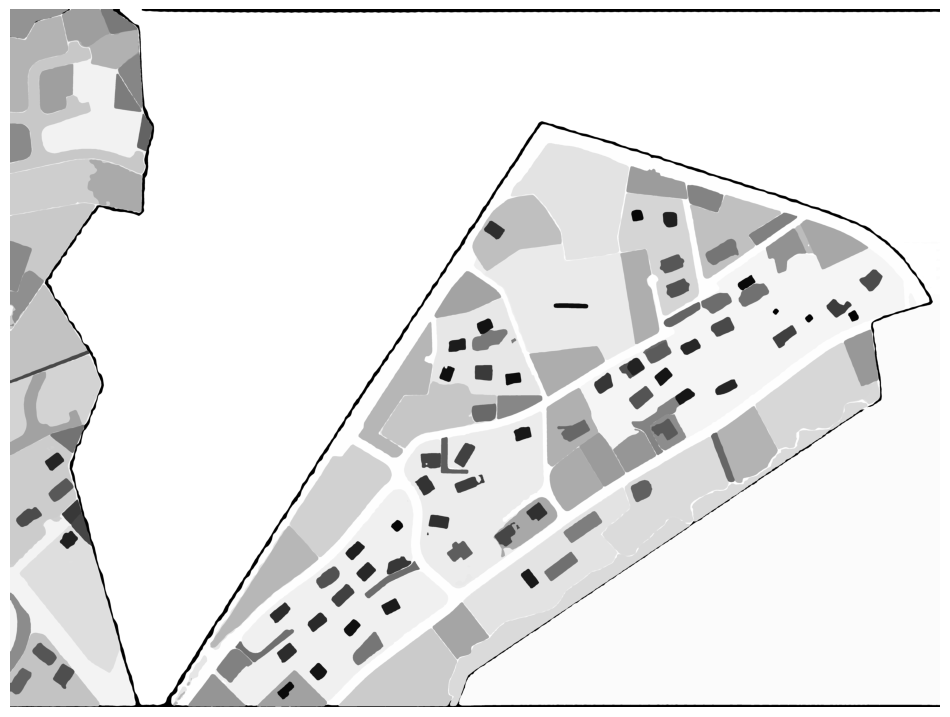

In [5]:
# Generate object masks and save results to a GeoTIFF file
sam.generate(image, output="masks.tif", foreground=True, unique=True)

# Show generated masks
sam.show_masks(cmap="binary_r")


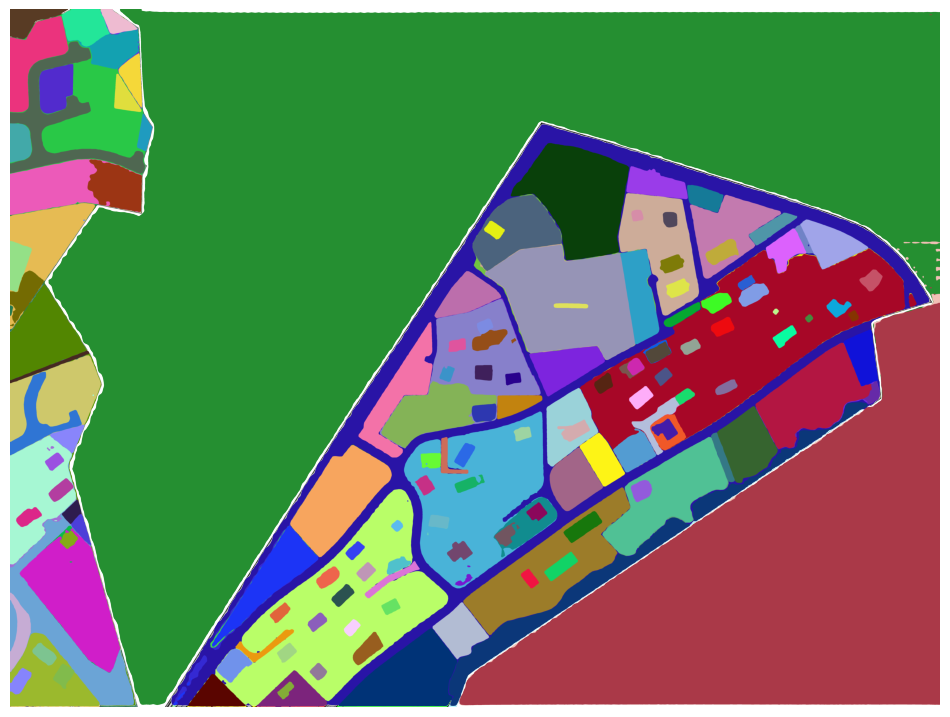

In [6]:
# Show annotations (random colors for objects) and save to a GeoTIFF file
sam.show_anns(axis="off", alpha=1, output="annotations.tif")



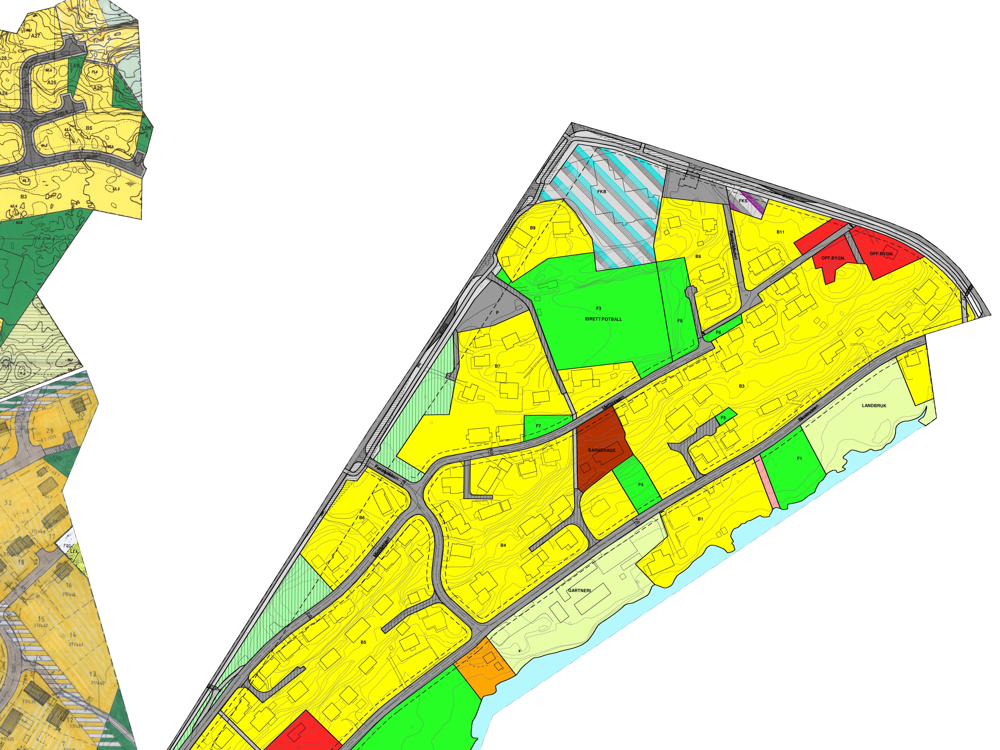
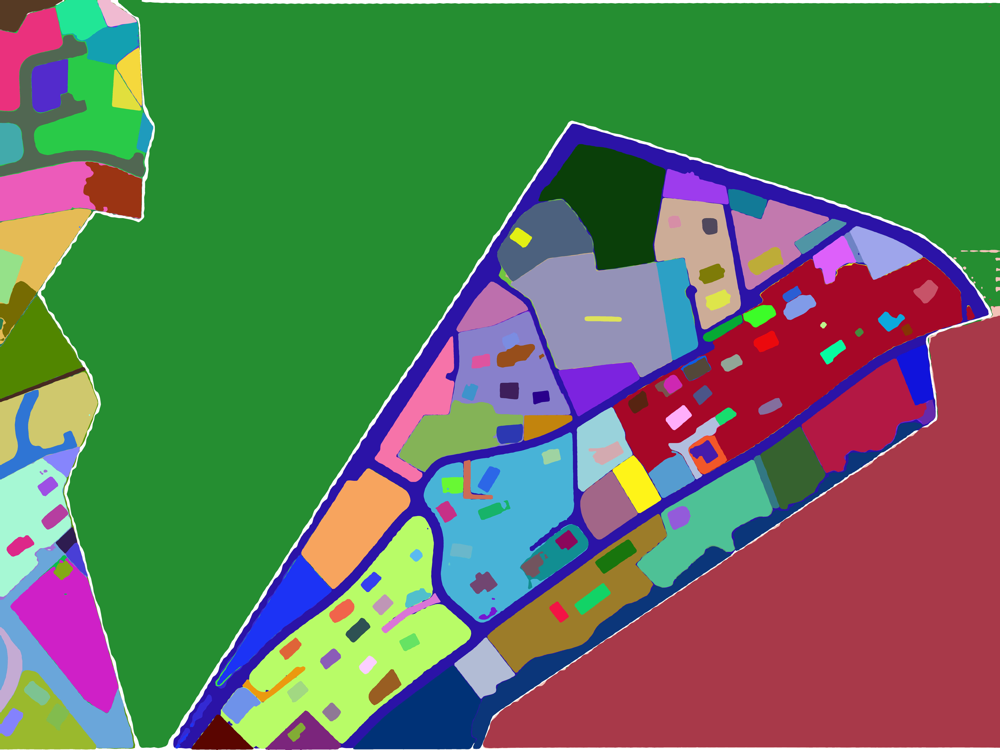

In [11]:
# Compare original image and annotations
leafmap.image_comparison(
    "ScanAI/SamGeo/Rensvik.tif",
    "annotations.tif",
    label1="Satellite Image",
    label2="Object Annotations",
)


In [12]:
# Add masks to the map
m.add_raster("annotations.tif", alpha=0.5, layer_name="Masks")
m


Map(center=[63.0966015, 7.8194035], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title'…

In [15]:
overlay_images(image, "annotations.tif", backend="Agg")
